<a href="https://colab.research.google.com/github/1oneweeek/TIL/blob/main/yolov1_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import torch
import tqdm
import numpy as np
import pandas as pd
from PIL import Image
import torch.nn as nn
import matplotlib.pyplot as plt
from collections import Counter
import torchvision.transforms as transforms
import matplotlib.patches as patches
from torch.utils.data import Dataset, DataLoader

In [ ]:
torch.cuda.get_device_name()

'Tesla T4'

In [ ]:
def intersection_over_union(boxes_preds, boxes_labels, box_format="midpoint"):
    # [x, y, w, h]

    if box_format == "midpoint":
        box1_x1 = boxes_preds[..., 0:1] - boxes_preds[..., 2:3] / 2
        box1_y1 = boxes_preds[..., 1:2] - boxes_preds[..., 3:4] / 2
        box1_x2 = boxes_preds[..., 0:1] + boxes_preds[..., 2:3] / 2
        box1_y2 = boxes_preds[..., 1:2] + boxes_preds[..., 3:4] / 2
        box2_x1 = boxes_labels[..., 0:1] - boxes_labels[..., 2:3] / 2
        box2_y1 = boxes_labels[..., 1:2] - boxes_labels[..., 3:4] / 2
        box2_x2 = boxes_labels[..., 0:1] + boxes_labels[..., 2:3] / 2
        box2_y2 = boxes_labels[..., 1:2] + boxes_labels[..., 3:4] / 2

    elif box_format == "corners":
        box1_x1 = boxes_preds[..., 0:1]
        box1_y1 = boxes_preds[..., 1:2]
        box1_x2 = boxes_preds[..., 2:3]
        box1_y2 = boxes_preds[..., 3:4]
        box2_x1 = boxes_labels[..., 0:1]
        box2_y1 = boxes_labels[..., 1:2]
        box2_x2 = boxes_labels[..., 2:3]
        box2_y2 = boxes_labels[..., 3:4]

    x1 = torch.max(box1_x1, box2_x1)
    y1 = torch.max(box1_y1, box2_y1)
    x2 = torch.min(box1_x2, box2_x2)
    y2 = torch.min(box1_y2, box2_y2)

    intersection_area = (x2 - x1).clamp(0) * (y2 - y1).clamp(0)
    box1_area = abs((box1_x2 - box1_x1) * (box1_y2 - box1_y1))
    box2_area = abs((box2_x2 - box2_x1) * (box2_y2 - box2_y1))

    return intersection_area / (box1_area + box2_area - intersection_area + 1e-6)

In [ ]:
def non_max_supression(bboxes, iou_threshold, prob_threshold, box_format="midpoint"):
    # [pred_class, prob_score, x, y, w, h]

    bboxes = [box for box in bboxes if box[1] > prob_threshold]
    bboxes = sorted(bboxes, key=lambda x: x[1], reverse=True)
    final_bboxes = []

    while bboxes:
        curr_box = bboxes.pop(0)
        bboxes = [box for box in bboxes if box[0] != curr_box[0]
                  or intersection_over_union(torch.tensor(curr_box[2:]), torch.tensor(box[2:]),box_format) < iou_threshold]

        final_bboxes.append(curr_box)

    return final_bboxes

In [ ]:
def mean_average_precision(pred_boxes, true_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=20):
    # [img_idx, pred_class, prob_score, x, y, w, h]

    epsilon = 1e-6
    avg_precis = []

    for i in range(num_classes):
        detections = []
        ground_truths = []

        for pred_box, true_box in zip(pred_boxes, true_boxes):
            if pred_box[1] == i:
                detections.append(pred_box)

            if true_box[1] == i:
                ground_truths.append(true_box)

        bbox_counter = Counter([gt[0] for gt in ground_truths])
        for key, val in bbox_counter.items():
            bbox_counter[key] = torch.zeros(val)

        detections.sort(key=lambda x: x[2], reverse=True)
        true_positives = torch.zeros(len(detections))
        false_positives = torch.zeros(len(detections))
        total_true_bboxes = len(ground_truths)

        for detection_idx, detection in enumerate(detections):
            gt_img_bboxes = [bbox for bbox in ground_truths if bbox[0] == detection[0]]
            num_gt_bboxes = len(gt_img_bboxes)
            best_iou = 0

            for idx, gt in enumerate(gt_img_bboxes):
                iou = intersection_over_union(torch.tensor(detection[3:]), torch.tensor(gt[3:]), box_format)
                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = idx

            if best_iou > iou_threshold:
                if bbox_counter[detection[0]][best_gt_idx] == 0:
                    true_positives[detection_idx] = 1
                else:
                    false_positives[detection_idx] = 1
            else:
                false_positives[detection_idx] = 1

        tp_cumsum = torch.cumsum(true_positives, dim=0)
        fp_cumsum = torch.cumsum(false_positives, dim=0)

        precisions = tp_cumsum / (tp_cumsum + fp_cumsum + epsilon)
        recalls = tp_cumsum / (total_true_bboxes + epsilon)
        precisions = torch.cat((torch.tensor([1]), precisions))
        recalls = torch.cat((torch.tensor([0]), recalls))
        avg_precis.append(torch.trapz(precisions, recalls))

    mAP = sum(avg_precis) / len(avg_precis)
    return mAP

In [ ]:
def convert_cellboxes(preds, s=7):
    preds = preds.to("cpu")
    bs = preds.shape[0]
    preds = preds.reshape(bs, 7, 7, 30)

    bbox1 = preds[..., 21:25]
    bbox2 = preds[..., 26:30]
    scores = torch.cat((preds[..., 20].unsqueeze(0), preds[..., 25].unsqueeze(0)), dim=0)

    best_idx = scores.argmax(0).unsqueeze(-1)
    best_box = bbox1 * (1 - best_idx) + best_idx * bbox2

    cell_indices = torch.arange(7).repeat(bs, 7, 1).unsqueeze(-1)
    x = 1 / s * (best_box[..., :1] + cell_indices)
    y = 1 / s * (best_box[..., 1:2] + cell_indices.permute(0, 2, 1, 3))
    wh = 1 / s * best_box[..., 2:4]
    converted_bbox = torch.cat((x, y, wh), dim=-1)

    pred_class = preds[..., :20].argmax(-1).unsqueeze(-1)
    best_prob = torch.max(preds[..., 20], preds[..., 25]).unsqueeze(-1)

    converted_preds = torch.cat(
        (pred_class, best_prob, converted_bbox), dim=-1)

    return converted_preds

In [ ]:
def cellboxes_to_boxes(preds, s=7):
    bs = preds.shape[0]
    converted_preds = convert_cellboxes(preds, s).reshape(bs, s * s, -1)
    converted_preds[..., 0] = converted_preds[..., 0].long()
    all_bboxes = []

    for i in range(bs):
        bboxes = []
        for j in range(s * s):
            bboxes.append([x.item() for x in converted_preds[i, j, :]])

        all_bboxes.append(bboxes)

    return all_bboxes

In [ ]:
def get_bboxes(net, batches, iou_threshold, prob_threshold, device, box_format="midpoint"):
    net.eval()
    all_pred_bboxes = []
    all_true_bboxes = []
    img_idx = 0

    for X, y in batches:
        X = X.to(device)
        y = y.to(device)

        with torch.no_grad():
            preds = net(X)

        bs = preds.shape[0]
        pred_bboxes = cellboxes_to_boxes(preds)
        true_bboxes = cellboxes_to_boxes(y)

        for i in range(bs):
            nms_bboxes = non_max_supression(pred_bboxes[i], iou_threshold, prob_threshold, box_format)

            for nms_bbox in nms_bboxes:
                all_pred_bboxes.append([img_idx] + nms_bbox)

            for true_bbox in true_bboxes[i]:
                if true_bbox[1] > prob_threshold:
                    all_true_bboxes.append([img_idx] + true_bbox)

            img_idx += 1

    net.train()

    return all_pred_bboxes, all_true_bboxes

In [ ]:
def plot_image(img, bboxes, class_dict=None):
    img = np.array(img)
    h, w, c = img.shape

    fig, ax = plt.subplots(1)
    ax.imshow(img)

    for bbox in bboxes:
        if class_dict is not None:
            pred_class = class_dict[int(bbox[0])]
        else:
            pred_class = int(bbox[0])

        prob_score = bbox[1]
        bbox = bbox[2:]
        upper_left_x = bbox[0] - bbox[2] / 2
        upper_left_y = bbox[1] - bbox[3] / 3

        rectangle = patches.Rectangle((upper_left_x * w, upper_left_y * h), bbox[2] * w, bbox[3] * h,
                                      linewidth=2, edgecolor="r", facecolor="none")
        label_patch = patches.Rectangle((upper_left_x * w, (upper_left_y * h) - 25), (bbox[2] * w) * 2 / 3, 25,
                                        alpha=1.0, color="r")

        ax.add_patch(rectangle)
        ax.add_patch(label_patch)
        plt.text(upper_left_x * w, (upper_left_y * h) - 10, f"{pred_class}({prob_score:.2f})")

    plt.show()

In [ ]:
def save_checkpoint(net, opt, filename):
    check_point = {"net_dict": net.state_dict(), "opt_dict": opt.state_dict()}
    torch.save(check_point, filename)
    print("Checkpoint Saved!")
    print("")

def load_checkpoint(net, opt, filename):
    check_point = torch.load(filename)
    net.load_state_dict(check_point["net_dict"])
    opt.load_state_dict(check_point["opt_dict"])
    print("Checkpoint Loaded!")
    print("")

In [ ]:
class LoadDataset(Dataset):
    def __init__(self, csv_file, img_dir, label_dir, transform, s=7, b=2, c=20):
        self.df = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.label_dir = label_dir
        self.transform = transform
        self.s = s
        self.b = b
        self.c = c

    def __len__(self):
        return len(self.df)

    def __getitem__(self, index):
        boxes = []
        label_path = os.path.join(self.label_dir, self.df.iloc[index, 1])

        with open(label_path) as f:
            for label in f.readlines():
                class_label, x, y, w, h = [float(i) if float(i) != int(float(i)) else int(i) for i in label.replace("n", "").split()]
                boxes.append([class_label, x, y, w, h])

        boxes = torch.tensor(boxes)
        img_path = os.path.join(self.img_dir, self.df.iloc[index, 0])
        img = Image.open(img_path)
        if self.transform:
            img, boxes = self.transform(img, boxes)

        label = torch.zeros((self.s, self.s, self.c + (self.b * 5)))
        for box in boxes:
            class_label, x, y, w, h = box.tolist()
            class_label = int(class_label)

            i, j = int(self.s * y), int(self.s * x)
            x_cell, y_cell, w_cell, h_cell = self.s * x - j, self.s * y - i, self.s * w, self.s * h

            if label[i, j, 20] == 0:
                label[i, j, 20] = 1
                label[i, j, class_label] = 1
                label[i, j, 21:25] = torch.tensor([x_cell, y_cell, w_cell, h_cell])

        return img, label

In [ ]:
architecture = [(7, 64, 2, 3),
                "M",
                (3, 192, 1, 1),
                "M",
                (1, 128, 1, 0),
                (3, 256, 1, 1),
                (1, 256, 1, 0),
                (3, 512, 1, 1),
                "M",
                [(1, 256, 1, 0), (3, 512, 1, 1), 4],
                (1, 512, 1, 0),
                (3, 1024, 1, 1),
                "M",
                [(1, 512, 1, 0), (3, 1024, 1, 1), 2],
                (3, 1024, 1, 1),
                (3, 1024, 2, 1),
                (3, 1024, 1, 1),
                (3, 1024, 1, 1)]

In [ ]:

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, **kwargs):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, bias=False, **kwargs)
        self.batchnorm = nn.BatchNorm2d(out_channels)
        self.leakyrelu = nn.LeakyReLU(0.1)

    def forward(self, x):
        return self.leakyrelu(self.batchnorm(self.conv(x)))

In [ ]:
class YoloNet(nn.Module):
    def __init__(self, in_channels=3, architecture=architecture, **kwargs):
        super().__init__()
        self.darknet = self.get_darknet(in_channels, architecture)
        self.fc_layers = self.get_fc_layers(**kwargs)

    def get_darknet(self, in_channels, architecture):
        layers = []

        for a in architecture:
            if type(a) == tuple:
                layers += [ConvBlock(in_channels, a[1], kernel_size=a[0], stride=a[2], padding=a[3])]
                in_channels = a[1]

            elif type(a) == str:
                layers += [nn.MaxPool2d(kernel_size=(2, 2), stride=(2, 2))]

            elif type(a) == list:
                conv1 = a[0]
                conv2 = a[1]
                num_repeats = a[2]

                for _ in range(num_repeats):
                    layers += [ConvBlock(in_channels, conv1[1], kernel_size=conv1[0], stride=conv1[2], padding=conv1[3])]
                    layers += [ConvBlock(conv1[1], conv2[1], kernel_size=conv2[0], stride=conv2[2], padding=conv2[3])]
                    in_channels = conv2[1]

        return nn.Sequential(*layers)

    def get_fc_layers(self, split_size, num_boxes, num_classes):
        s, b, c = split_size, num_boxes, num_classes
        layers = nn.Sequential(nn.Flatten(),
                               nn.Linear(1024 * s * s, 496),
                               nn.LeakyReLU(0.1),
                               nn.Linear(496, s * s * (c + (b * 5))))

        return layers

    def forward(self, x):
        return self.fc_layers(torch.flatten(self.darknet(x), start_dim=1))


In [ ]:
class LossFn(nn.Module):
    def __init__(self, s=7, b=2, c=20):
        super().__init__()
        self.s = s
        self.b = b
        self.c = c
        self.mse = nn.MSELoss(reduction="sum")
        self.lambda_coord = 5
        self.lambda_noobj = 0.5

    def forward(self, preds, targets):
        preds = preds.reshape(-1, self.s, self.s, self.c + self.b * 5)

        iou_b1 = intersection_over_union(preds[..., 21:25], targets[..., 21:25])
        iou_b2 = intersection_over_union(preds[..., 26:30], targets[..., 21:25])
        ious = torch.cat([iou_b1.unsqueeze(0), iou_b2.unsqueeze(0)], dim=0)

        max_iou, best_box = torch.max(ious, dim=0)
        box_exists = targets[..., 20].unsqueeze(3)

        box_preds = box_exists * (best_box * preds[..., 26:30] + (1 - best_box) * preds[..., 21:25])
        box_targets = box_exists * targets[..., 21:25]

        box_preds[..., 2:4] = torch.sign(
            box_preds[..., 2:4]) * torch.sqrt(torch.abs(box_preds[..., 2:4] + 1e-6))
        box_targets[..., 2:4] = torch.sqrt(box_targets[..., 2:4])

        box_loss = self.mse(torch.flatten(box_preds, end_dim=-2),
                            torch.flatten(box_targets, end_dim=-2))

        pred_box = best_box * preds[..., 25:26] + (1 - best_box) * preds[..., 20:21]

        object_loss = self.mse(torch.flatten(box_exists * pred_box),
                               torch.flatten(box_exists * targets[..., 20:21]))

        no_object_loss = self.mse(torch.flatten((1 - box_exists) * preds[..., 20:21], start_dim=1),
                                  torch.flatten((1 - box_exists) * targets[..., 20:21], start_dim=1))

        no_object_loss += self.mse(torch.flatten((1 - box_exists) * preds[..., 25:26], start_dim=1),
                                   torch.flatten((1 - box_exists) * targets[..., 20:21], start_dim=1))

        class_loss = self.mse(torch.flatten(box_exists * preds[..., :20], end_dim=-2),
                              torch.flatten(box_exists * targets[..., :20], end_dim=-2))

        loss = self.lambda_coord * box_loss + object_loss + self.lambda_noobj * no_object_loss + class_loss

        return loss


In [ ]:
class Compose(object):
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, img, bbox):
        for t in self.transforms:
            img, bbox = t(img), bbox

        return img, bbox

In [ ]:
def loop(batches, net, opt, loss_fn, train, device):
    epoch_loss = []

    if train:
        net.train()
        print("Train Loop:")
        print("")

        for X, y in tqdm.tqdm(batches, total=len(batches)):
            X = X.to(device)
            y = y.to(device)

            output = net(X)
            loss = loss_fn(output, y)

            opt.zero_grad()
            loss.backward()
            opt.step()
            epoch_loss.append(loss.item())

    else:
        net.eval()
        print("Test Loop:")
        print("")

        with torch.no_grad():
            for X, y in tqdm.tqdm(batches, total=len(batches)):
                X = X.to(device)
                y = y.to(device)

                output = net(X)
                loss = loss_fn(output, y)
                epoch_loss.append(loss.item())

    print("")
    print("")

    return sum(epoch_loss) / len(epoch_loss)

In [ ]:
def display_images(batches, net, class_dict=None):
    net.eval()
    print("Displaying images...")
    print("")
    for X, y in batches:
        X = X.to(device)

        for i in range(10):
            bboxes = net(X)
            bboxes = cellboxes_to_boxes(bboxes)
            bboxes = non_max_supression(bboxes[i], iou_threshold=0.5,
                                        prob_threshold=0.4)
            img = X[i].permute(1, 2, 0).to("cpu")
            plot_image(img, bboxes, class_dict)

        break

In [ ]:
lr = 2e-5
device = "cuda" if torch.cuda.is_available() else "cpu"
batch_size = 16
epochs = 100
img_dir = "/content/drive/MyDrive/torch_study/object detection/sample_pascal_voc/images"
label_dir = "/content/drive/MyDrive/torch_study/object detection/sample_pascal_voc/labels"

In [ ]:
device

'cuda'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
class_dict = {0: "aeroplane", 1: "bicycle", 2: "bird", 3: "boat", 4: "bottle",
              5: "bus", 6: "car", 7: "cat", 8: "chair", 9: "cow",
              10: "diningtable", 11: "dog", 12: "horse", 13: "motorbike", 14: "human",
              15: "plant", 16: "sheep", 17: "sofa", 18: "train", 19: "monitor"}


transform = Compose([transforms.Resize((448, 448)),
                     transforms.ToTensor()])


train_data = LoadDataset("/content/drive/MyDrive/torch_study/object detection/sample_pascal_voc/1500examples.csv", img_dir, label_dir, transform)
# test_data = LoadDataset("pascal_voc/test.csv", img_dir, label_dir, transform=None)


len(train_data)

1515

In [ ]:
train_batches = DataLoader(train_data, batch_size=batch_size, num_workers=2, pin_memory=True, shuffle=True, drop_last=True)
# test_batches = DataLoader(test_data, batch_size=batch_size, num_workers=2, pin_memory=True, shuffle=True, drop_last=True)


len(train_batches)

94

In [ ]:
net = YoloNet(split_size=7, num_boxes=2, num_classes=20).to(device)
net

YoloNet(
  (darknet): Sequential(
    (0): ConvBlock(
      (conv): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (batchnorm): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (leakyrelu): LeakyReLU(negative_slope=0.1)
    )
    (1): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
    (2): ConvBlock(
      (conv): Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (batchnorm): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (leakyrelu): LeakyReLU(negative_slope=0.1)
    )
    (3): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
    (4): ConvBlock(
      (conv): Conv2d(192, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (batchnorm): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (leakyrelu): LeakyReLU(negative_slope=0.1

In [ ]:
loss_fn = LossFn()
opt = torch.optim.Adam(net.parameters(), lr)

Train Loop:



  0%|          | 0/94 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
100%|██████████| 94/94 [06:22<00:00,  4.51s/it]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
100%|██████████| 94/94 [06:22<00:00,  4.07s/it]

 epoch: 0 | train_loss: 497.55889405595497 | train_mAP: 0.0003245145780965686

Displaying images...



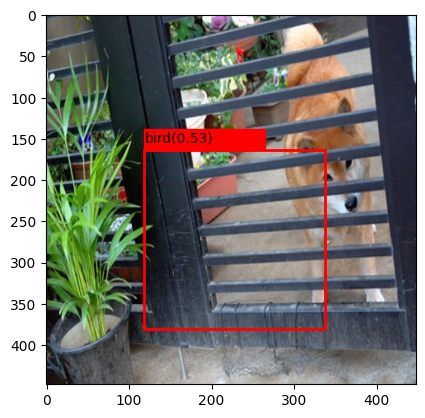

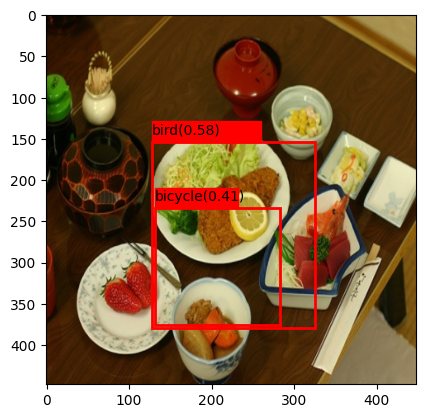

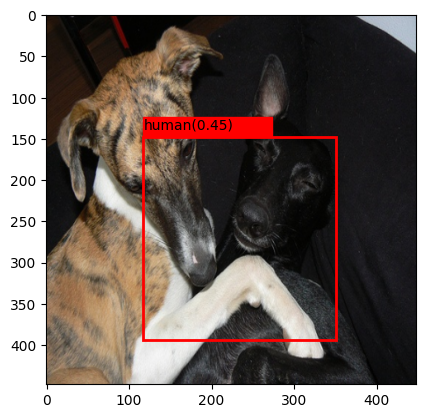

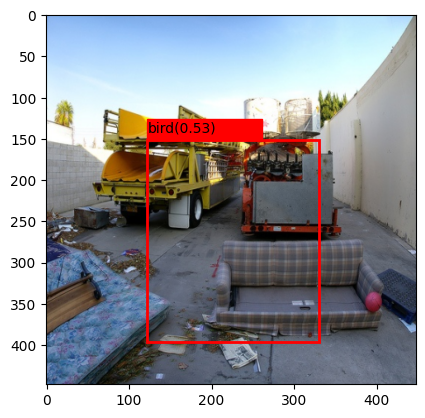

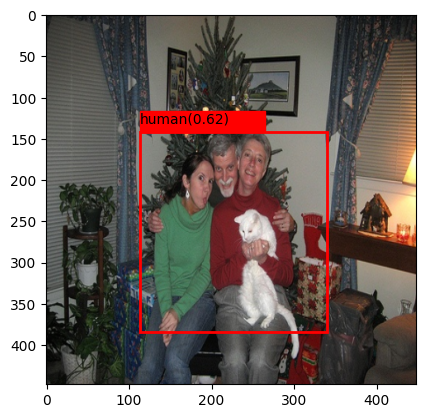

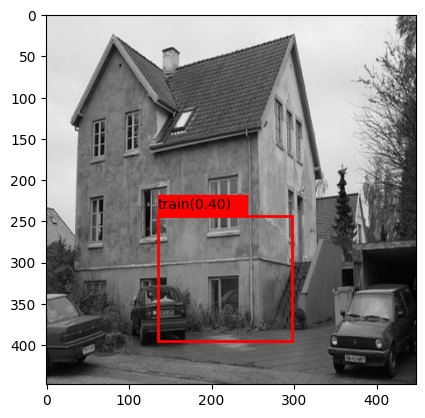

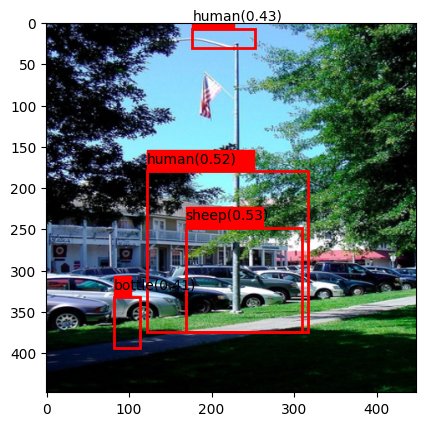

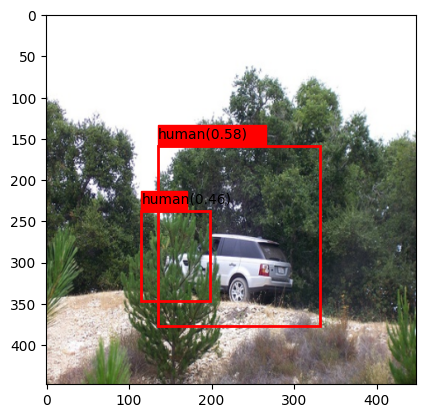

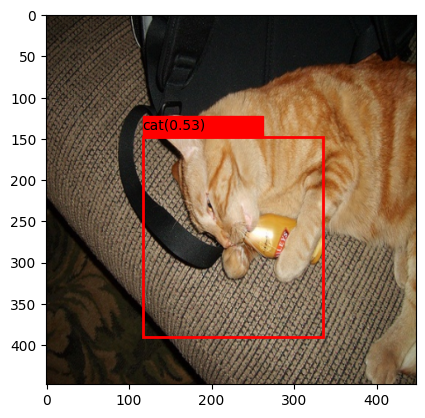

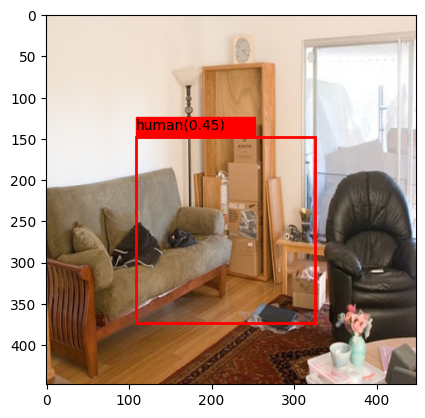

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.84it/s]

 epoch: 1 | train_loss: 246.45224550937084 | train_mAP: 0.0035463098902255297

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.77it/s]

 epoch: 2 | train_loss: 187.53645024401075 | train_mAP: 0.005878966301679611

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.76it/s]

 epoch: 3 | train_loss: 165.91052984684072 | train_mAP: 0.00550521444529295

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.82it/s]

 epoch: 4 | train_loss: 152.51803304793987 | train_mAP: 0.011472770944237709

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.82it/s]

 epoch: 5 | train_loss: 141.2976631813861 | train_mAP: 0.02595565654337406

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.81it/s]

 epoch: 6 | train_loss: 132.27401644118288 | train_mAP: 0.044535569846630096

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.78it/s]

 epoch: 7 | train_loss: 123.85238907185007 | train_mAP: 0.07454431056976318

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.82it/s]

 epoch: 8 | train_loss: 116.6148621579434 | train_mAP: 0.1685153990983963

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.84it/s]

 epoch: 9 | train_loss: 110.66192456509205 | train_mAP: 0.20190474390983582

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.81it/s]

 epoch: 10 | train_loss: 104.10477824921304 | train_mAP: 0.26782017946243286

Displaying images...



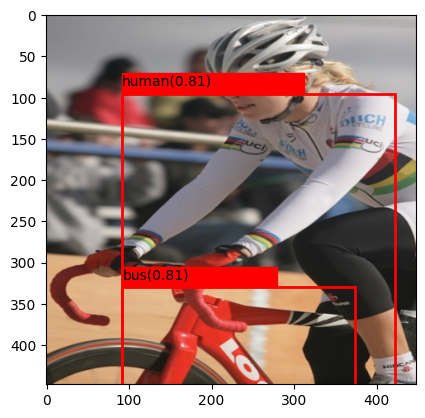

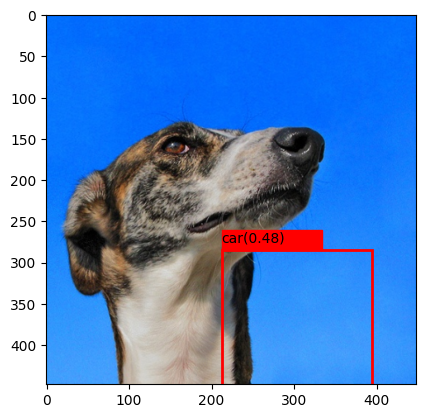

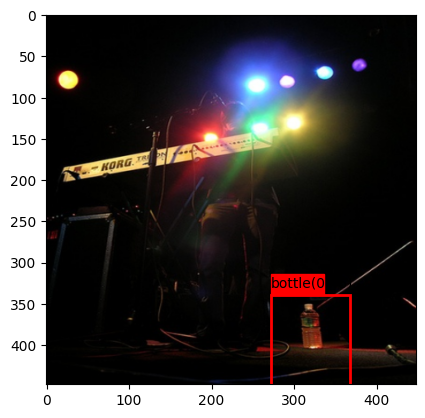

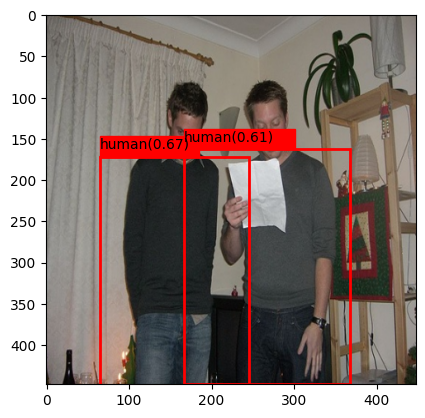

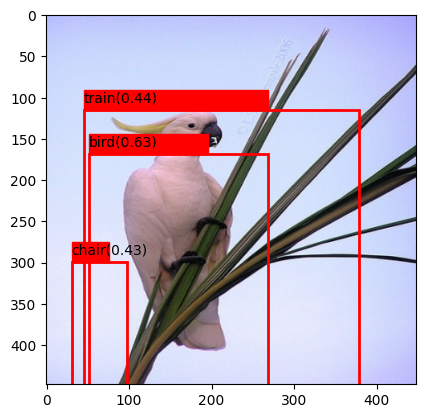

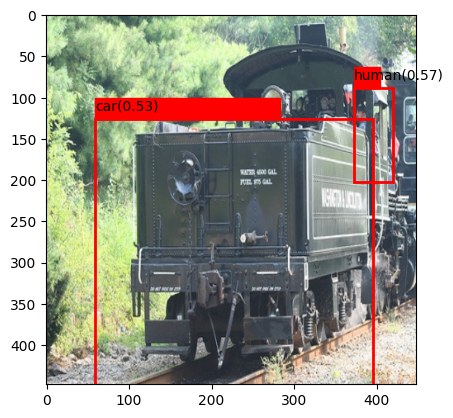

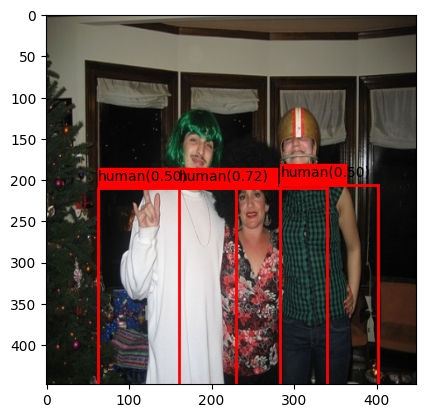

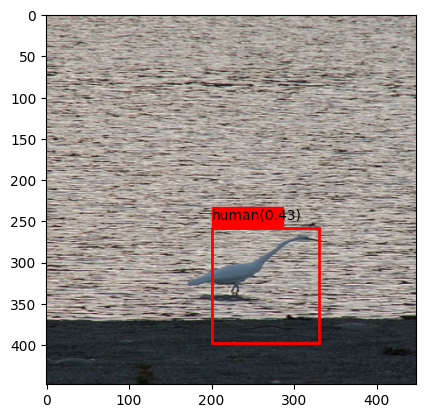

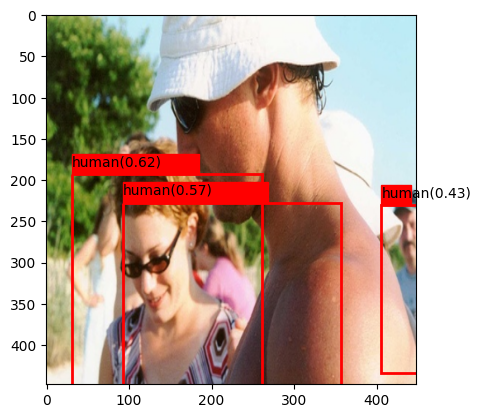

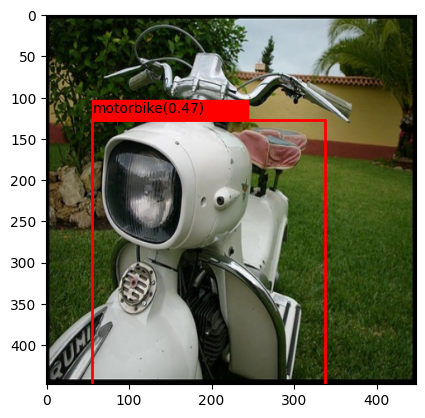

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.73it/s]

 epoch: 11 | train_loss: 98.55170440673828 | train_mAP: 0.3398687243461609

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.76it/s]

 epoch: 12 | train_loss: 94.74256491153798 | train_mAP: 0.36298245191574097

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.73it/s]

 epoch: 13 | train_loss: 91.58439563183074 | train_mAP: 0.42847108840942383

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.78it/s]

 epoch: 14 | train_loss: 84.94915519876683 | train_mAP: 0.35552507638931274

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.80it/s]

 epoch: 15 | train_loss: 82.83649623140376 | train_mAP: 0.478401243686676

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.70it/s]

 epoch: 16 | train_loss: 76.28409499310433 | train_mAP: 0.5086736679077148

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.80it/s]

 epoch: 17 | train_loss: 74.72596785362731 | train_mAP: 0.5039101243019104

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.76it/s]

 epoch: 18 | train_loss: 73.33022409804325 | train_mAP: 0.5303748846054077

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.79it/s]

 epoch: 19 | train_loss: 72.9840322453925 | train_mAP: 0.5533506274223328

Train Loop:



100%|██████████| 94/94 [00:33<00:00,  2.79it/s]

 epoch: 20 | train_loss: 69.12201881408691 | train_mAP: 0.5496079921722412

Displaying images...



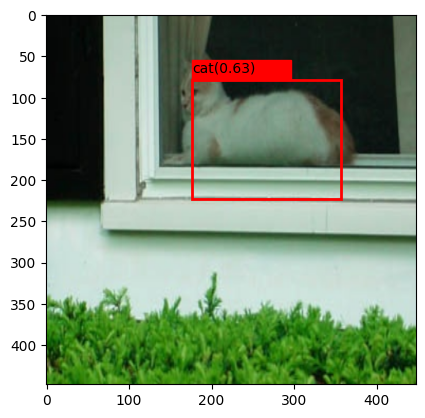

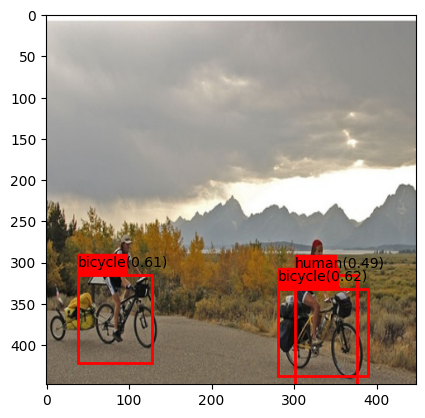

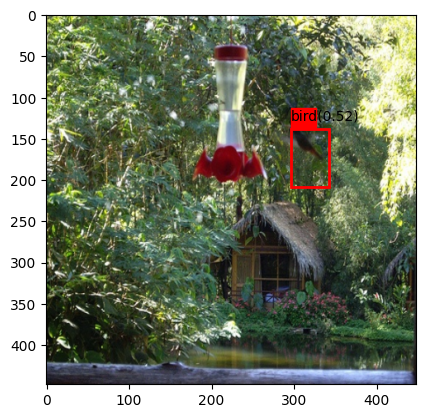

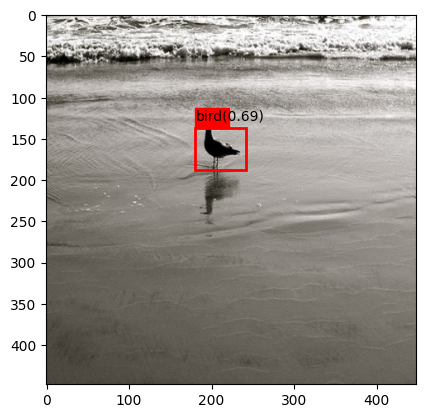

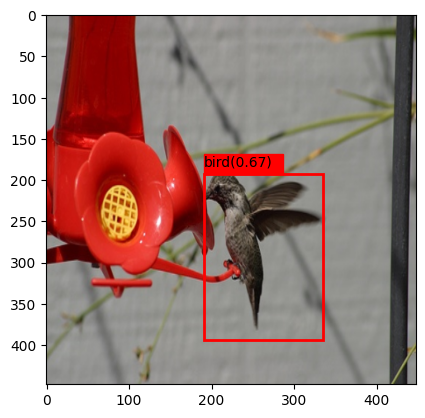

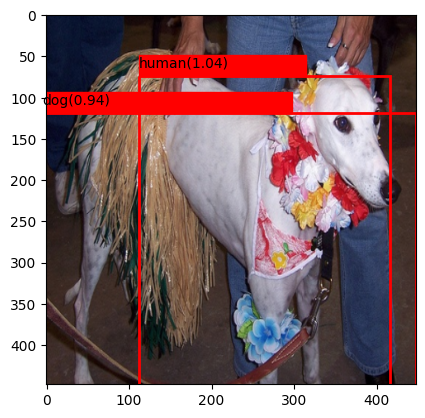

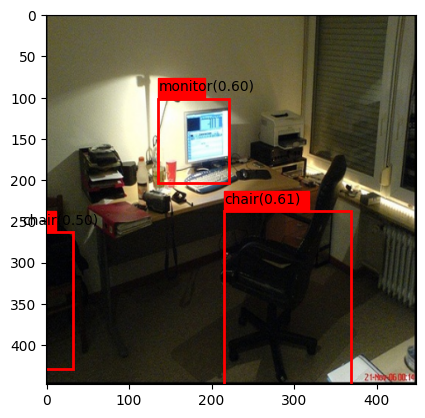

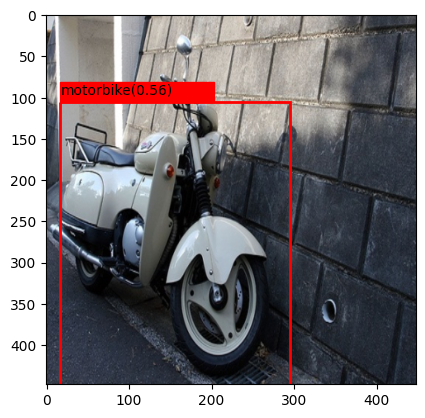

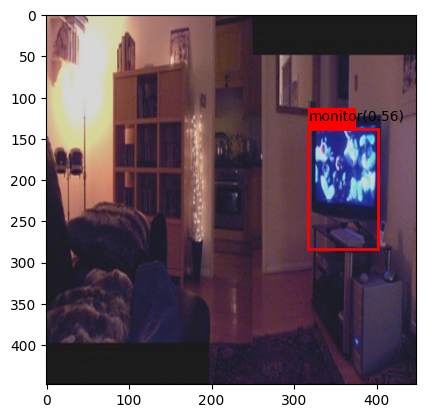

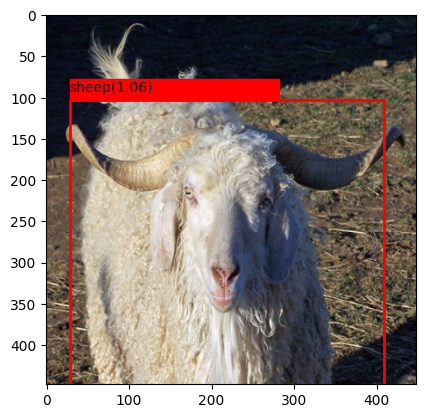

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.75it/s]

 epoch: 21 | train_loss: 66.08588429714771 | train_mAP: 0.5526238679885864

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.75it/s]

 epoch: 22 | train_loss: 66.8710114499356 | train_mAP: 0.5058453679084778

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.72it/s]

 epoch: 23 | train_loss: 69.46420673613852 | train_mAP: 0.5901597142219543

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.70it/s]

 epoch: 24 | train_loss: 64.22308653973519 | train_mAP: 0.5391836762428284

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.71it/s]

 epoch: 25 | train_loss: 62.74994659423828 | train_mAP: 0.5880122780799866

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.65it/s]

 epoch: 26 | train_loss: 61.23309837503636 | train_mAP: 0.6213558316230774

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.64it/s]

 epoch: 27 | train_loss: 58.4121731291426 | train_mAP: 0.5914857983589172

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.70it/s]

 epoch: 28 | train_loss: 56.88035404935796 | train_mAP: 0.6294670701026917

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.70it/s]

 epoch: 29 | train_loss: 56.92049838126974 | train_mAP: 0.6467827558517456

Train Loop:



100%|██████████| 94/94 [00:34<00:00,  2.72it/s]

 epoch: 30 | train_loss: 53.40605918397295 | train_mAP: 0.6703775525093079

Displaying images...



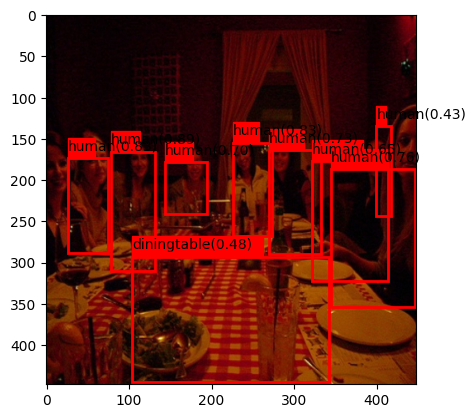

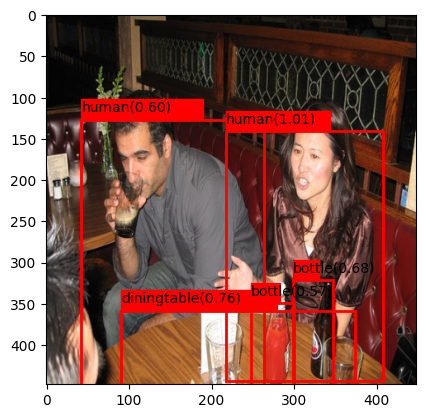

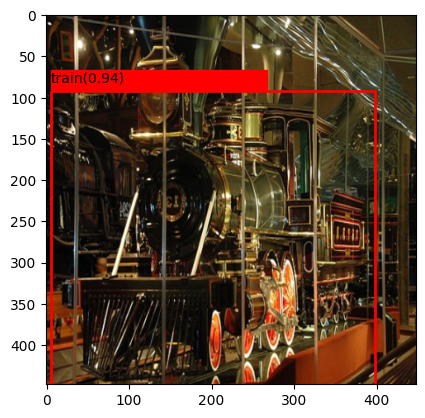

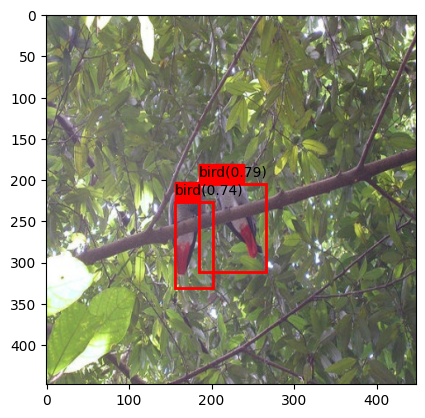

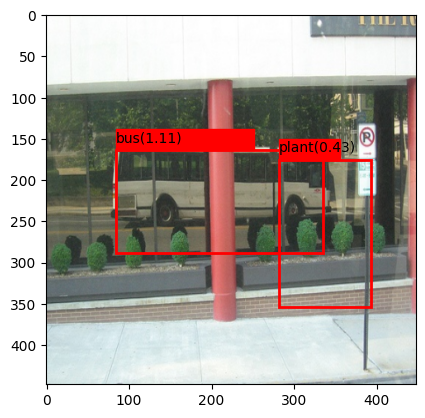

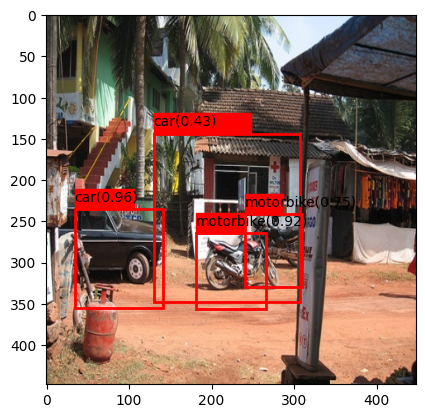

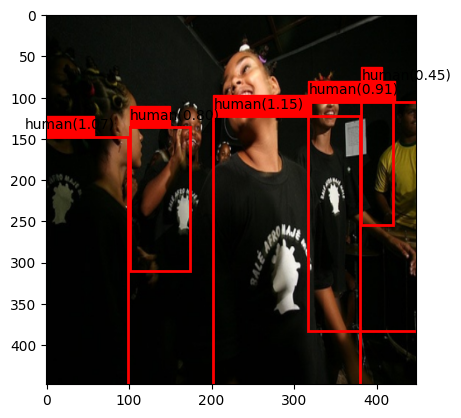

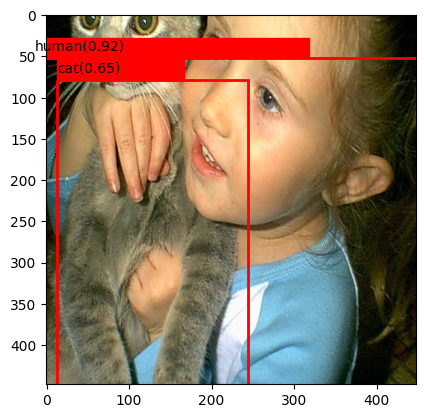

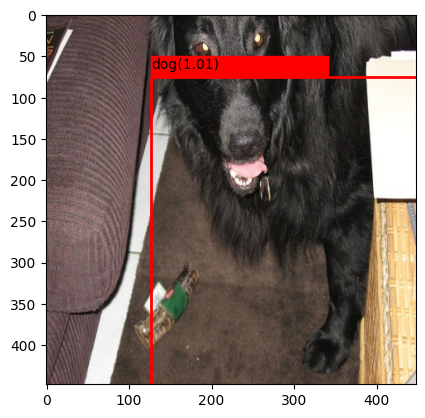

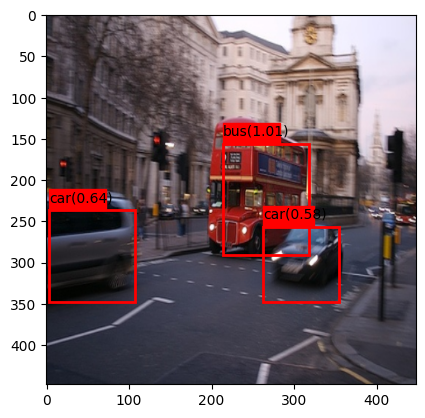

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.63it/s]

 epoch: 31 | train_loss: 53.36144613712392 | train_mAP: 0.665378212928772

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.64it/s]

 epoch: 32 | train_loss: 52.54881885203909 | train_mAP: 0.6606022119522095

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.59it/s]

 epoch: 33 | train_loss: 49.2011863018604 | train_mAP: 0.6292136907577515

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.66it/s]

 epoch: 34 | train_loss: 47.645357679813465 | train_mAP: 0.7093068957328796

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.60it/s]

 epoch: 35 | train_loss: 47.130127135743486 | train_mAP: 0.6552178263664246

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.66it/s]

 epoch: 36 | train_loss: 47.71649222678327 | train_mAP: 0.6785736083984375

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.63it/s]

 epoch: 37 | train_loss: 46.123508189586886 | train_mAP: 0.724489152431488

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.55it/s]

 epoch: 38 | train_loss: 45.40847066108217 | train_mAP: 0.7200511693954468

Train Loop:



100%|██████████| 94/94 [00:35<00:00,  2.62it/s]

 epoch: 39 | train_loss: 86.49293345593392 | train_mAP: 0.586007297039032

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.60it/s]

 epoch: 40 | train_loss: 65.3450676126683 | train_mAP: 0.6289064884185791

Displaying images...



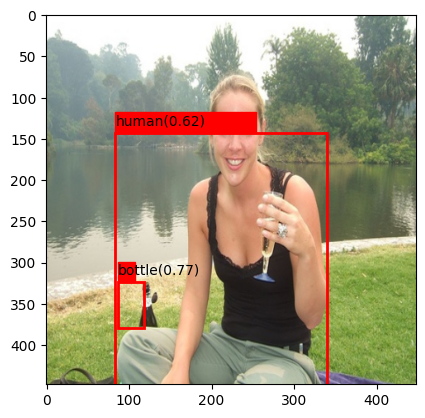

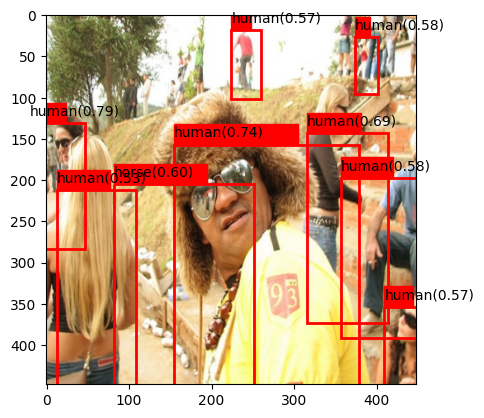

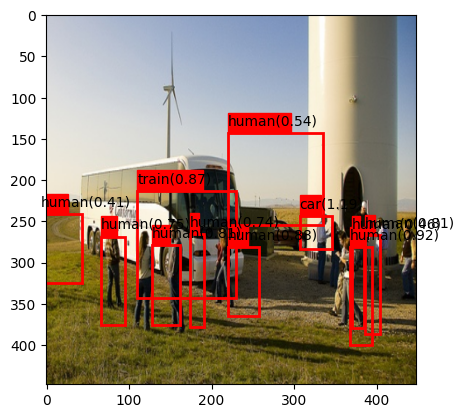

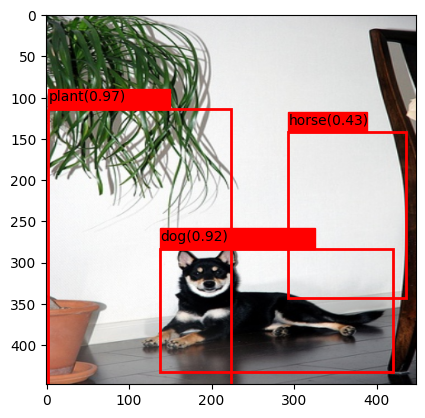

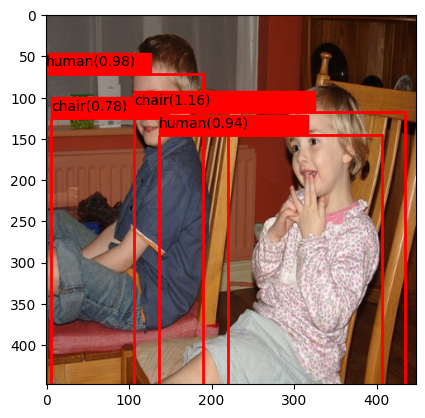

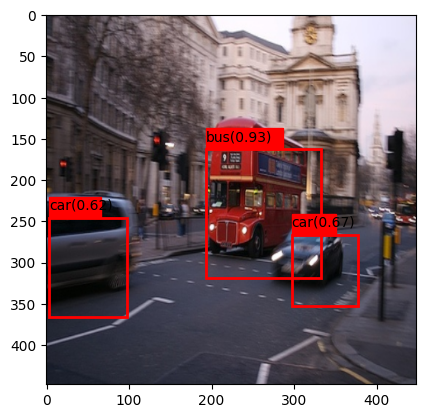

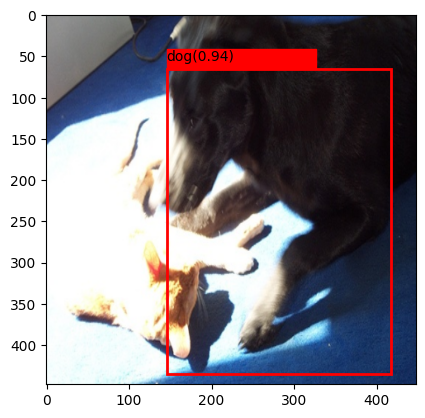

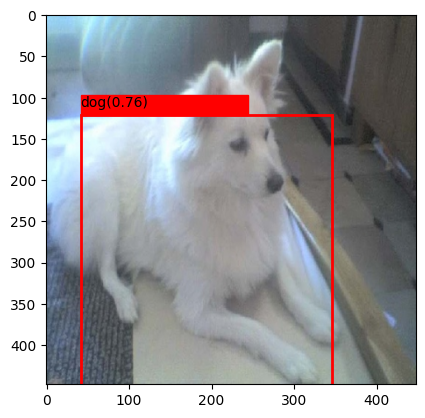

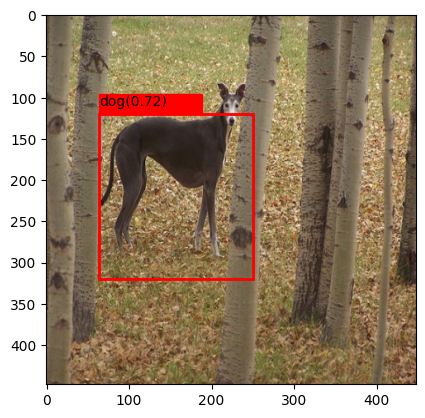

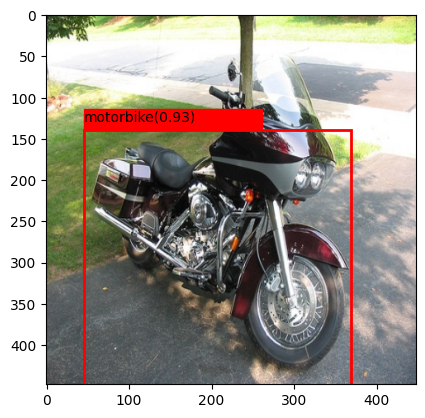

Train Loop:



100%|██████████| 94/94 [00:37<00:00,  2.51it/s]

 epoch: 41 | train_loss: 56.93223772657679 | train_mAP: 0.695397138595581

Train Loop:



100%|██████████| 94/94 [00:37<00:00,  2.50it/s]

 epoch: 42 | train_loss: 45.73162634829257 | train_mAP: 0.7603508234024048

Train Loop:



100%|██████████| 94/94 [00:37<00:00,  2.54it/s]

 epoch: 43 | train_loss: 40.98413154926706 | train_mAP: 0.7522224187850952

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.47it/s]

 epoch: 44 | train_loss: 38.70588947864289 | train_mAP: 0.754135012626648

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.55it/s]

 epoch: 45 | train_loss: 36.75725384976001 | train_mAP: 0.7761759161949158

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.43it/s]

 epoch: 46 | train_loss: 33.827015978224736 | train_mAP: 0.7882424592971802

Train Loop:



100%|██████████| 94/94 [00:36<00:00,  2.56it/s]

 epoch: 47 | train_loss: 33.654594157604464 | train_mAP: 0.8110333681106567

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.44it/s]

 epoch: 48 | train_loss: 33.10244517630719 | train_mAP: 0.8101959228515625

Train Loop:



100%|██████████| 94/94 [00:37<00:00,  2.50it/s]

 epoch: 49 | train_loss: 34.498555528356675 | train_mAP: 0.7997625470161438

Train Loop:



100%|██████████| 94/94 [00:37<00:00,  2.51it/s]

 epoch: 50 | train_loss: 33.20622194574234 | train_mAP: 0.7862305045127869

Displaying images...



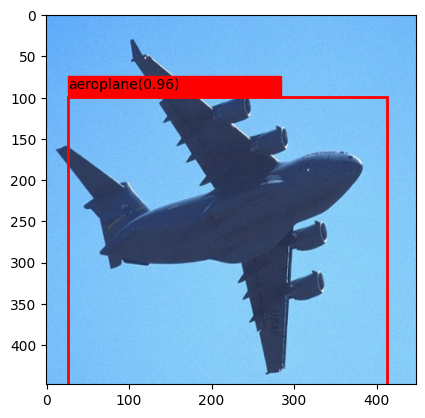

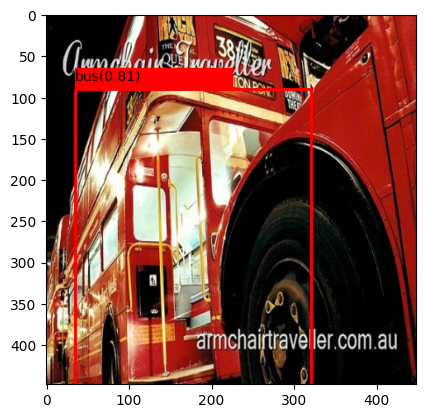

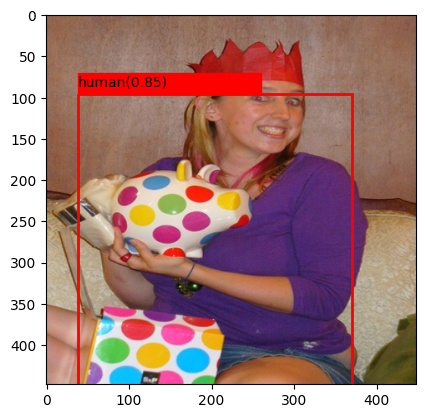

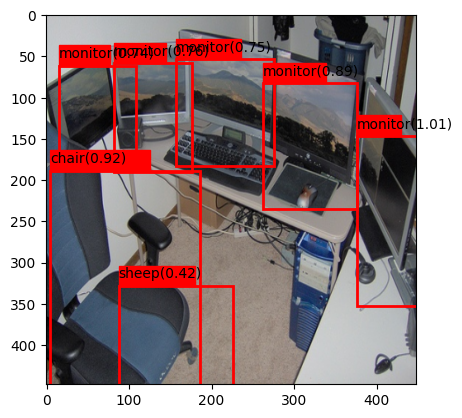

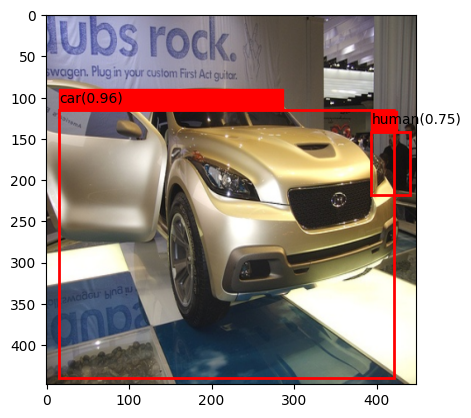

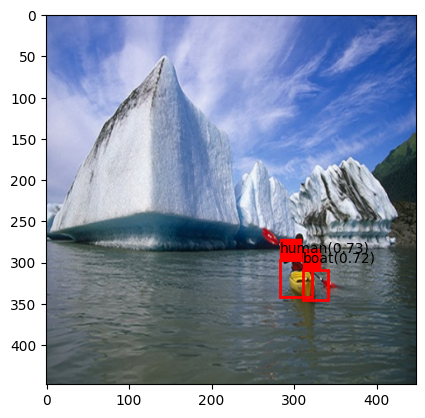

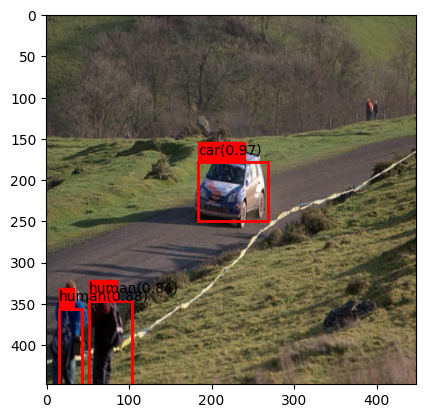

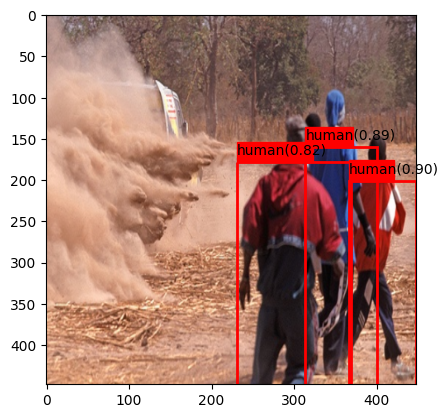

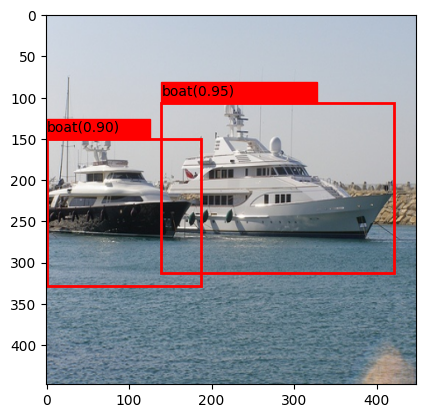

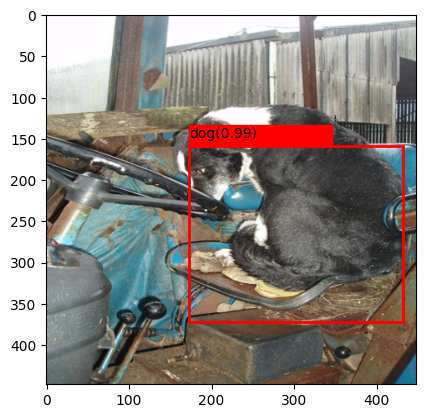

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.45it/s]

 epoch: 51 | train_loss: 32.23681918610918 | train_mAP: 0.8071147203445435

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.39it/s]

 epoch: 52 | train_loss: 33.359834386947306 | train_mAP: 0.7991093397140503

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.43it/s]

 epoch: 53 | train_loss: 33.46654674854685 | train_mAP: 0.7680134177207947

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.41it/s]

 epoch: 54 | train_loss: 33.43779036339293 | train_mAP: 0.8051732778549194

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.45it/s]

 epoch: 55 | train_loss: 30.742223039586495 | train_mAP: 0.8268545866012573

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.42it/s]

 epoch: 56 | train_loss: 32.16890651621717 | train_mAP: 0.7887369394302368

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.44it/s]

 epoch: 57 | train_loss: 35.736429802914884 | train_mAP: 0.7355196475982666

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.45it/s]

 epoch: 58 | train_loss: 32.31974206072219 | train_mAP: 0.7952552437782288

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.38it/s]

 epoch: 59 | train_loss: 30.422130178897937 | train_mAP: 0.8197582960128784

Train Loop:



100%|██████████| 94/94 [00:38<00:00,  2.45it/s]

 epoch: 60 | train_loss: 27.731231385088982 | train_mAP: 0.8270705938339233

Displaying images...



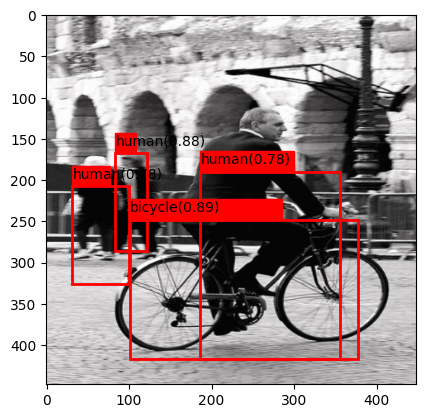

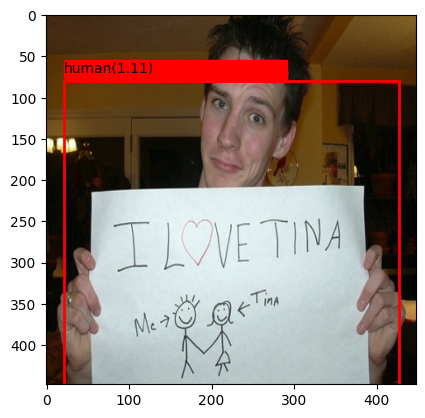

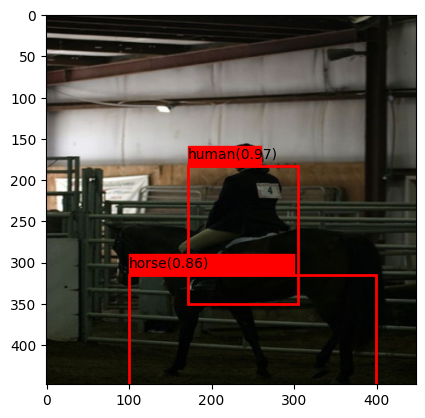

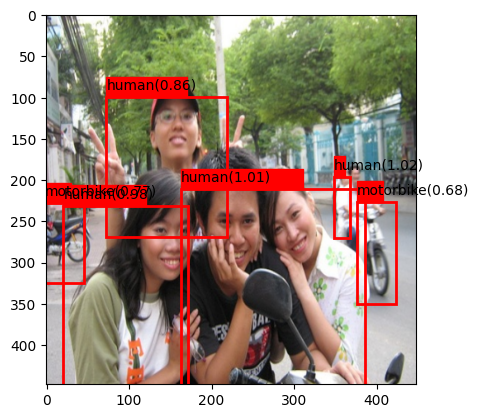

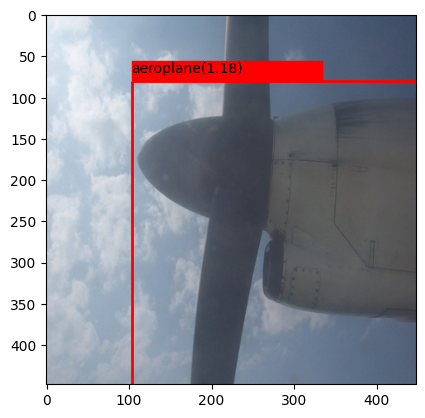

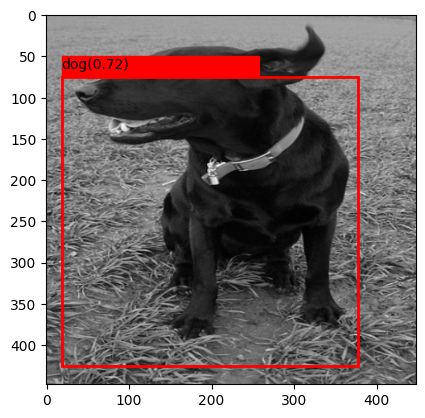

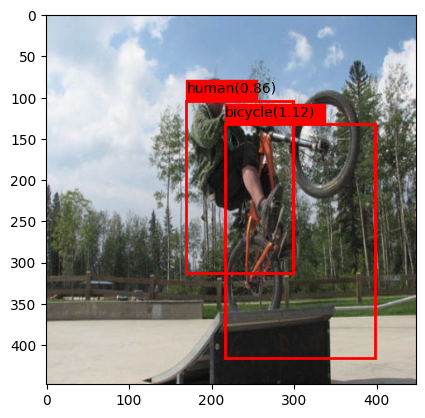

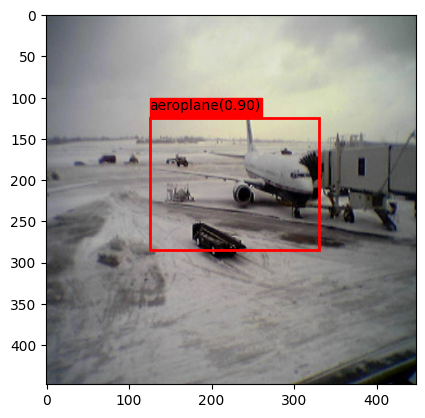

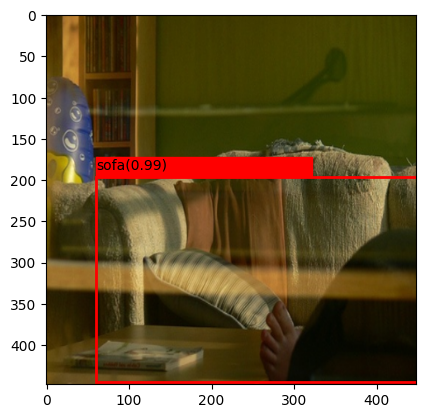

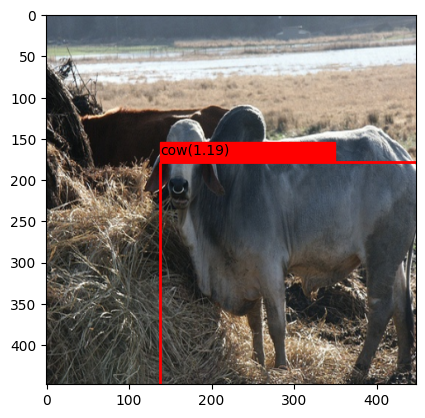

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.39it/s]

 epoch: 61 | train_loss: 28.29774955993003 | train_mAP: 0.8173292875289917

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.32it/s]

 epoch: 62 | train_loss: 27.59192839074642 | train_mAP: 0.8259519338607788

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.40it/s]

 epoch: 63 | train_loss: 28.45612139397479 | train_mAP: 0.8337618708610535

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.34it/s]

 epoch: 64 | train_loss: 28.471002446844224 | train_mAP: 0.8141187429428101

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.37it/s]

 epoch: 65 | train_loss: 28.37742364152949 | train_mAP: 0.8243311643600464

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.30it/s]

 epoch: 66 | train_loss: 25.458559655128642 | train_mAP: 0.8314127922058105

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.37it/s]

 epoch: 67 | train_loss: 24.953281514188077 | train_mAP: 0.8464251756668091

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.34it/s]

 epoch: 68 | train_loss: 25.845959724263942 | train_mAP: 0.8248791694641113

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.34it/s]

 epoch: 69 | train_loss: 24.2952099049345 | train_mAP: 0.8219538927078247

Train Loop:



100%|██████████| 94/94 [00:39<00:00,  2.36it/s]

 epoch: 70 | train_loss: 24.486164468400023 | train_mAP: 0.8345276713371277

Displaying images...



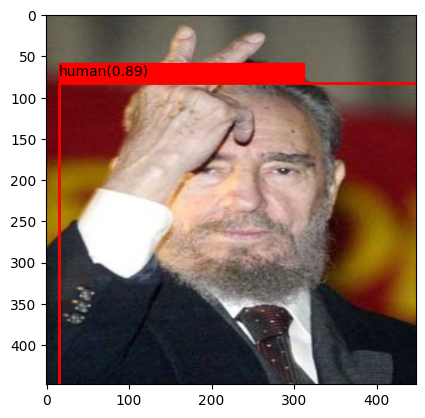

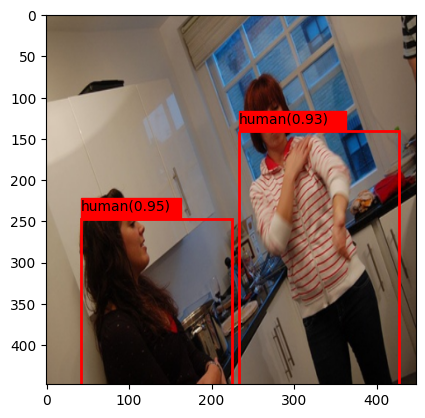

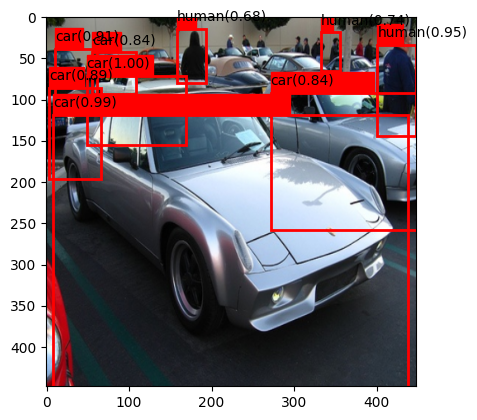

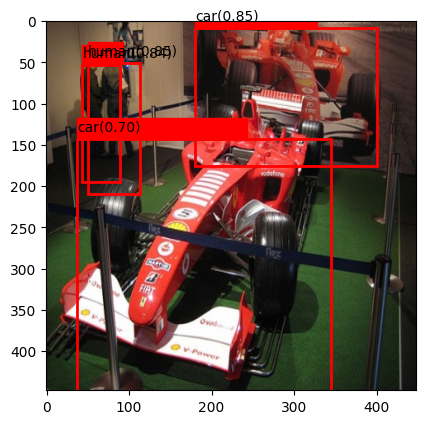

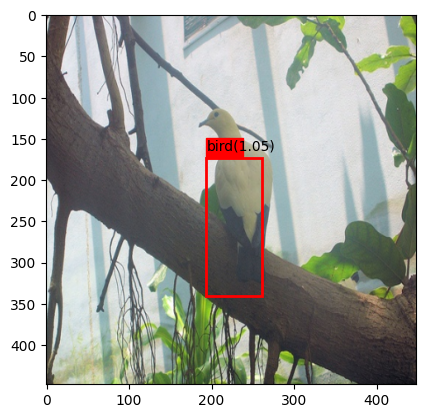

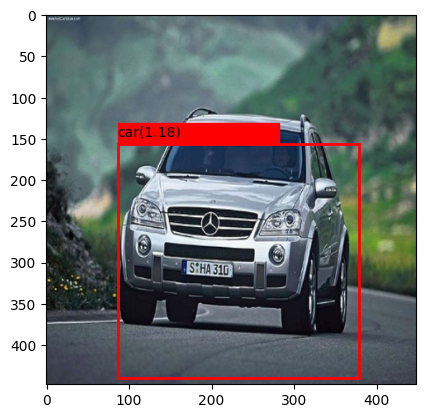

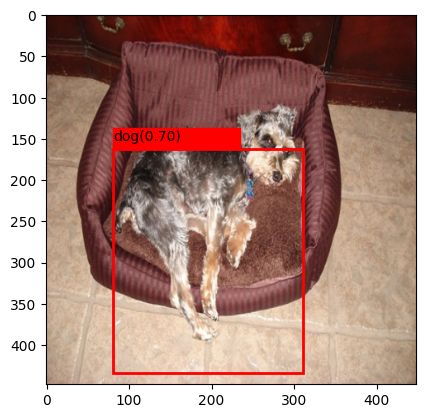

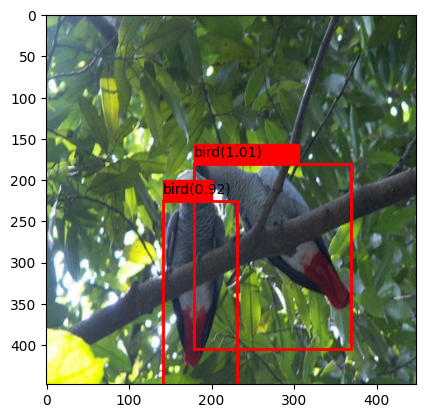

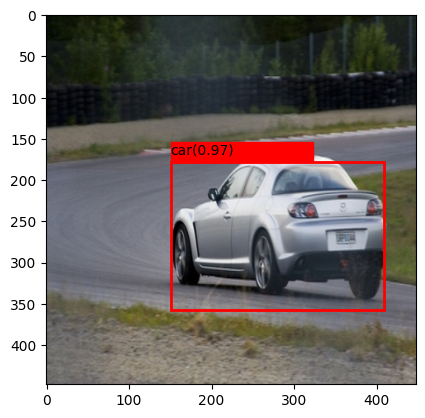

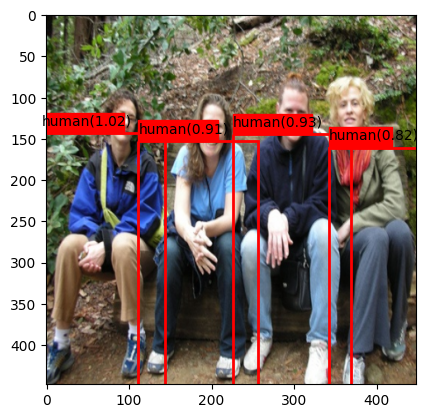

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.24it/s]

 epoch: 71 | train_loss: 25.350228289340404 | train_mAP: 0.8298595547676086

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.29it/s]

 epoch: 72 | train_loss: 23.634819000325304 | train_mAP: 0.8569108247756958

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.30it/s]

 epoch: 73 | train_loss: 25.091379733795815 | train_mAP: 0.8140735626220703

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.24it/s]

 epoch: 74 | train_loss: 24.61934898254719 | train_mAP: 0.8326117396354675

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.28it/s]

 epoch: 75 | train_loss: 23.121387786053596 | train_mAP: 0.8521296381950378

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.32it/s]

 epoch: 76 | train_loss: 22.695773195713123 | train_mAP: 0.8524770736694336

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.24it/s]

 epoch: 77 | train_loss: 22.337416202464002 | train_mAP: 0.8395021557807922

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.31it/s]

 epoch: 78 | train_loss: 22.03042313393126 | train_mAP: 0.855262279510498

Train Loop:



100%|██████████| 94/94 [00:40<00:00,  2.31it/s]

 epoch: 79 | train_loss: 20.772899749431204 | train_mAP: 0.8720736503601074

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.26it/s]

 epoch: 80 | train_loss: 20.41277258446876 | train_mAP: 0.8440915942192078

Displaying images...



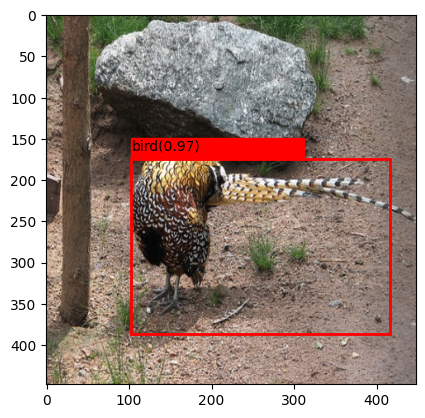

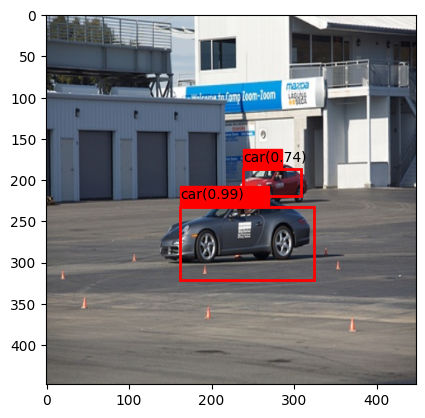

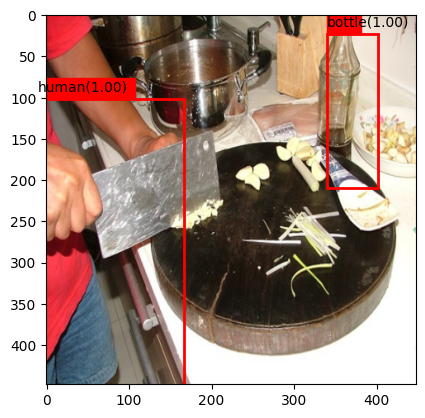

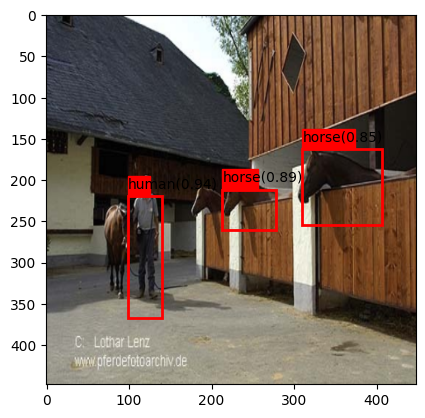

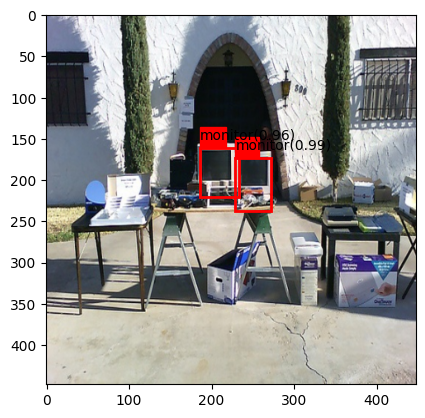

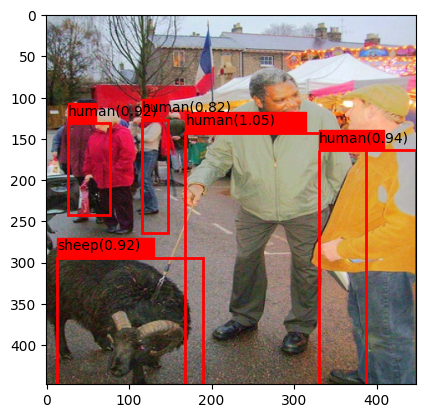

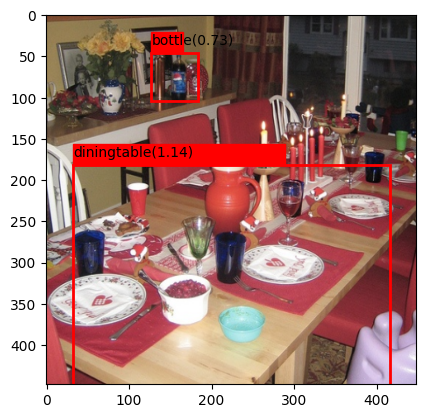

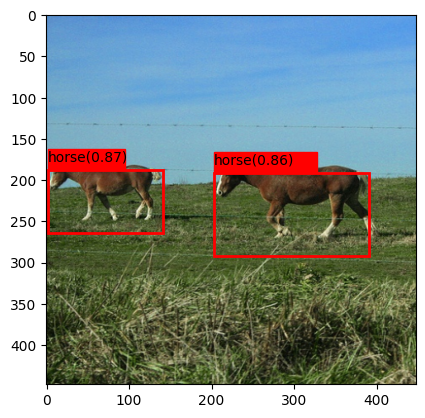

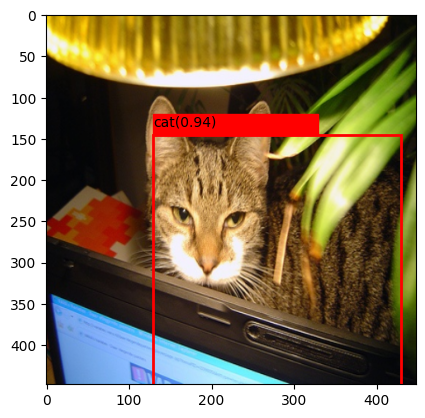

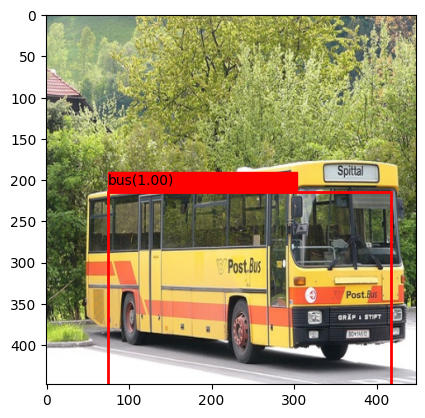

Train Loop:



100%|██████████| 94/94 [00:43<00:00,  2.18it/s]

 epoch: 81 | train_loss: 20.281039856849834 | train_mAP: 0.8529273867607117

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.27it/s]

 epoch: 82 | train_loss: 20.003792123591648 | train_mAP: 0.8264003992080688

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.20it/s]

 epoch: 83 | train_loss: 20.261062774252384 | train_mAP: 0.850376307964325

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.19it/s]

 epoch: 84 | train_loss: 21.06198216499166 | train_mAP: 0.84953773021698

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.22it/s]

 epoch: 85 | train_loss: 20.686562913529418 | train_mAP: 0.8588900566101074

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 86 | train_loss: 20.629920513071912 | train_mAP: 0.8526809811592102

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.20it/s]

 epoch: 87 | train_loss: 20.548696446926037 | train_mAP: 0.8688373565673828

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.27it/s]

 epoch: 88 | train_loss: 19.608096660451686 | train_mAP: 0.8802412748336792

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.24it/s]

 epoch: 89 | train_loss: 19.798052747198877 | train_mAP: 0.8711107969284058

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.21it/s]

 epoch: 90 | train_loss: 18.8470984215432 | train_mAP: 0.8690518140792847

Displaying images...



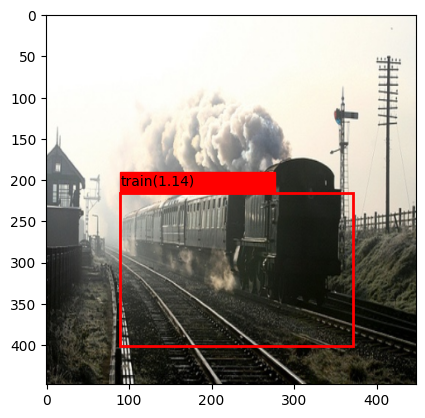

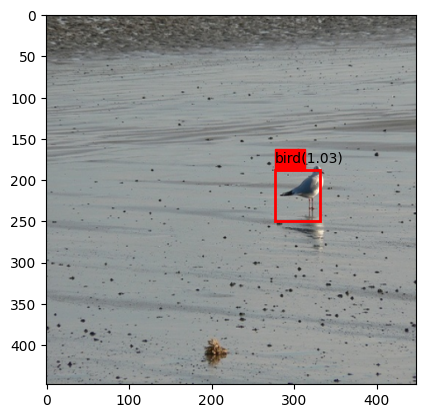

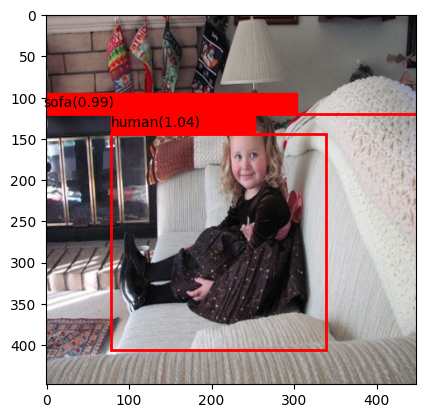

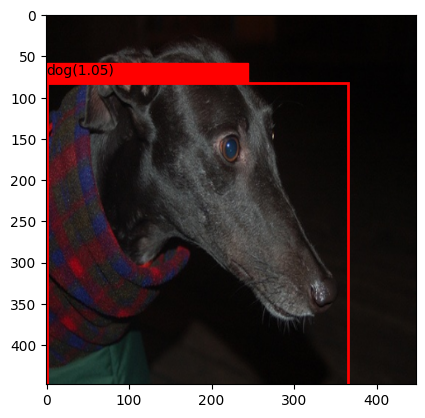

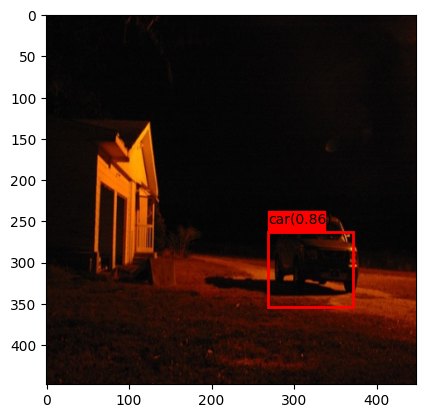

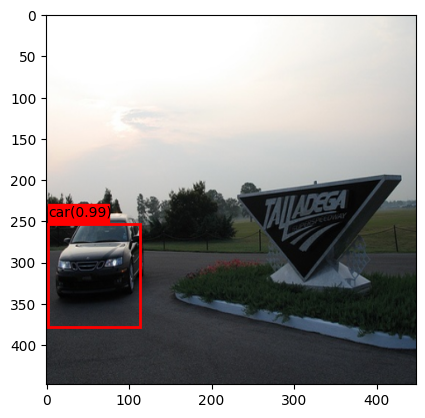

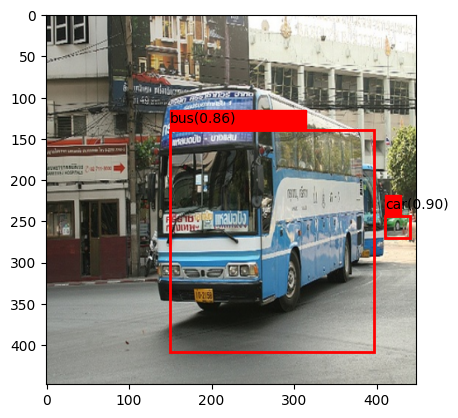

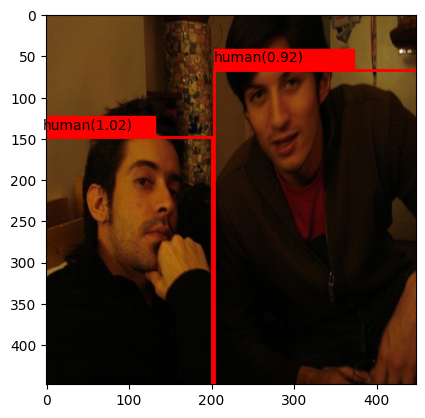

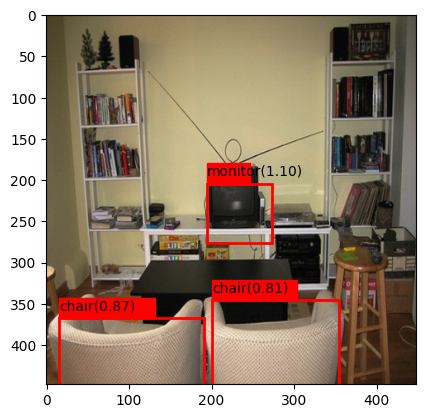

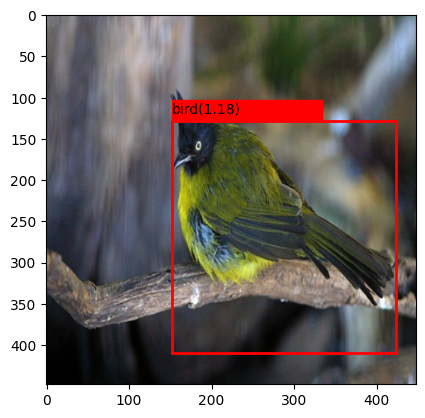

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 91 | train_loss: 18.34997361771604 | train_mAP: 0.8692662119865417

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 92 | train_loss: 24.135531273294003 | train_mAP: 0.7774944305419922

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 93 | train_loss: 28.375630216395603 | train_mAP: 0.813515305519104

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 94 | train_loss: 24.18063470150562 | train_mAP: 0.8469700813293457

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.24it/s]

 epoch: 95 | train_loss: 20.593927728368882 | train_mAP: 0.8752037882804871

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.19it/s]

 epoch: 96 | train_loss: 16.968024882864444 | train_mAP: 0.9038234949111938

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.23it/s]

 epoch: 97 | train_loss: 14.935049868644551 | train_mAP: 0.8985664248466492

Train Loop:



100%|██████████| 94/94 [00:42<00:00,  2.22it/s]

 epoch: 98 | train_loss: 13.999488764620843 | train_mAP: 0.8834012150764465

Train Loop:



100%|██████████| 94/94 [00:41<00:00,  2.25it/s]

 epoch: 99 | train_loss: 14.205707590630714 | train_mAP: 0.8898345232009888



In [ ]:
for epoch in range(epochs):
    train_loss = loop(train_batches, net, opt, loss_fn, True, device)
    # test_loss = loop(test_batches, net, opt, loss_fn, False, device)

    train_pred_bboxes, train_true_bboxes = get_bboxes(net, train_batches, iou_threshold=0.5, prob_threshold=0.4, device=device)
    train_mAP = mean_average_precision(train_pred_bboxes, train_true_bboxes)

    # test_pred_bboxes, test_true_bboxes = get_bboxes(net, test_batches, iou_threshold=0.5, prob_threshold=0.4, device=device)
    # test_mAP = mean_average_precision(test_pred_bboxes, test_true_bboxes)

    # print(f"epoch: {epoch} | train_loss: {train_loss} | train_mAP: {train_mAP} | test_loss: {test_loss} | test_mAP: {test_mAP}")
    print(f" epoch: {epoch} | train_loss: {train_loss} | train_mAP: {train_mAP}")
    print("")

    if epoch % 10 == 0:
        # display_images(test_batches, net, class_dict)
        display_images(train_batches, net, class_dict)
        # save_checkpoint(net, opt, f"checkpoint_{epoch}.pth.tar")